In [1]:
# Core libraries
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
from tqdm.notebook import tqdm  # Changed to notebook version
import time  # Added for timing

# Image processing
from PIL import Image
import cv2

# PyTorch
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms, models
import torch.nn.functional as F
from torch.cuda.amp import autocast, GradScaler  # Added for mixed precision

# Metrics
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

# Utilities
import warnings
warnings.filterwarnings('ignore')

# Set random seed for reproducibility
torch.manual_seed(42)
np.random.seed(42)
if torch.cuda.is_available():
    torch.cuda.manual_seed(42)
    torch.backends.cudnn.benchmark = True  # Enable CuDNN autotuner
    torch.backends.cudnn.deterministic = False  # Disable for speed

# Device configuration
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print("PyTorch version:", torch.__version__)
print("Device:", device)
if torch.cuda.is_available():
    print("GPU:", torch.cuda.get_device_name(0))
    print("GPU Memory:", round(torch.cuda.get_device_properties(0).total_memory / 1024**3, 2), "GB")
    print("CuDNN Benchmark:", torch.backends.cudnn.benchmark)
print("\nAll libraries imported successfully!")

PyTorch version: 2.7.1+cu118
Device: cuda
GPU: NVIDIA GeForce RTX 4060 Laptop GPU
GPU Memory: 8.0 GB
CuDNN Benchmark: True

All libraries imported successfully!


## 2. Dataset Exploration

In [3]:
# Define paths
train_dir = 'train'
val_dir = 'val'
test_dir = 'test'

# Get class names
class_names = sorted(os.listdir(train_dir))
num_classes = len(class_names)

print(f"Number of classes: {num_classes}")
print(f"\nClass names: {class_names}")

# Create class to index mapping
class_to_idx = {class_name: idx for idx, class_name in enumerate(class_names)}
idx_to_class = {idx: class_name for class_name, idx in class_to_idx.items()}

print(f"\nClass to index mapping: {class_to_idx}")

Number of classes: 31

Class names: ['Bangus', 'Big Head Carp', 'Black Spotted Barb', 'Catfish', 'Climbing Perch', 'Fourfinger Threadfin', 'Freshwater Eel', 'Glass Perchlet', 'Goby', 'Gold Fish', 'Gourami', 'Grass Carp', 'Green Spotted Puffer', 'Indian Carp', 'Indo-Pacific Tarpon', 'Jaguar Gapote', 'Janitor Fish', 'Knifefish', 'Long-Snouted Pipefish', 'Mosquito Fish', 'Mudfish', 'Mullet', 'Pangasius', 'Perch', 'Scat Fish', 'Silver Barb', 'Silver Carp', 'Silver Perch', 'Snakehead', 'Tenpounder', 'Tilapia']

Class to index mapping: {'Bangus': 0, 'Big Head Carp': 1, 'Black Spotted Barb': 2, 'Catfish': 3, 'Climbing Perch': 4, 'Fourfinger Threadfin': 5, 'Freshwater Eel': 6, 'Glass Perchlet': 7, 'Goby': 8, 'Gold Fish': 9, 'Gourami': 10, 'Grass Carp': 11, 'Green Spotted Puffer': 12, 'Indian Carp': 13, 'Indo-Pacific Tarpon': 14, 'Jaguar Gapote': 15, 'Janitor Fish': 16, 'Knifefish': 17, 'Long-Snouted Pipefish': 18, 'Mosquito Fish': 19, 'Mudfish': 20, 'Mullet': 21, 'Pangasius': 22, 'Perch': 23, 

In [4]:
# Count images in each split
def count_images(directory):
    counts = {}
    total = 0
    for class_name in class_names:
        class_path = os.path.join(directory, class_name)
        if os.path.exists(class_path):
            count = len([f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
            counts[class_name] = count
            total += count
    return counts, total

train_counts, train_total = count_images(train_dir)
val_counts, val_total = count_images(val_dir)
test_counts, test_total = count_images(test_dir)

print("Dataset Statistics:")
print(f"Training images: {train_total}")
print(f"Validation images: {val_total}")
print(f"Test images: {test_total}")
print(f"Total images: {train_total + val_total + test_total}")

Dataset Statistics:
Training images: 8801
Validation images: 2751
Test images: 1760
Total images: 13312


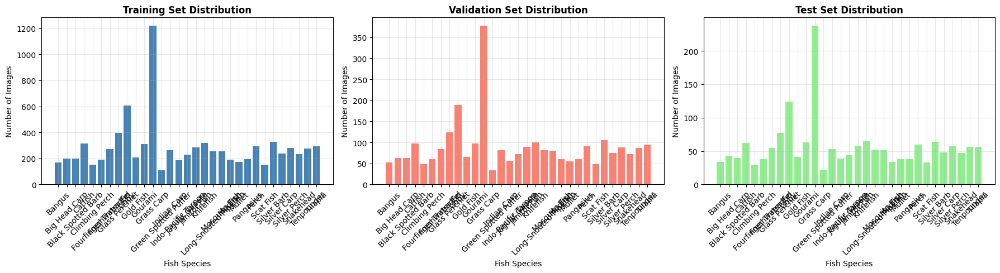


Detailed class distribution:
                    Class  Train  Val  Test  Total
0                  Bangus    171   52    34    257
1           Big Head Carp    201   63    43    307
2      Black Spotted Barb    200   63    40    303
3                 Catfish    314   97    62    473
4          Climbing Perch    152   48    30    230
5    Fourfinger Threadfin    191   60    38    289
6          Freshwater Eel    271   84    55    410
7          Glass Perchlet    397  124    77    598
8                    Goby    607  189   124    920
9               Gold Fish    206   65    41    312
10                Gourami    311   97    63    471
11             Grass Carp   1222  378   238   1838
12   Green Spotted Puffer    110   34    22    166
13            Indian Carp    262   81    53    396
14    Indo-Pacific Tarpon    186   57    39    282
15          Jaguar Gapote    229   72    44    345
16           Janitor Fish    286   89    58    433
17              Knifefish    319  100    65    484
1

In [5]:
# Visualize class distribution
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

axes[0].bar(train_counts.keys(), train_counts.values(), color='steelblue')
axes[0].set_title('Training Set Distribution', fontsize=12, fontweight='bold')
axes[0].set_xlabel('Fish Species')
axes[0].set_ylabel('Number of Images')
axes[0].tick_params(axis='x', rotation=45)
axes[0].grid(True, alpha=0.3)

axes[1].bar(val_counts.keys(), val_counts.values(), color='salmon')
axes[1].set_title('Validation Set Distribution', fontsize=12, fontweight='bold')
axes[1].set_xlabel('Fish Species')
axes[1].set_ylabel('Number of Images')
axes[1].tick_params(axis='x', rotation=45)
axes[1].grid(True, alpha=0.3)

axes[2].bar(test_counts.keys(), test_counts.values(), color='lightgreen')
axes[2].set_title('Test Set Distribution', fontsize=12, fontweight='bold')
axes[2].set_xlabel('Fish Species')
axes[2].set_ylabel('Number of Images')
axes[2].tick_params(axis='x', rotation=45)
axes[2].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Print detailed counts
print("\nDetailed class distribution:")
df_counts = pd.DataFrame({
    'Class': class_names,
    'Train': [train_counts.get(c, 0) for c in class_names],
    'Val': [val_counts.get(c, 0) for c in class_names],
    'Test': [test_counts.get(c, 0) for c in class_names]
})
df_counts['Total'] = df_counts['Train'] + df_counts['Val'] + df_counts['Test']
print(df_counts)

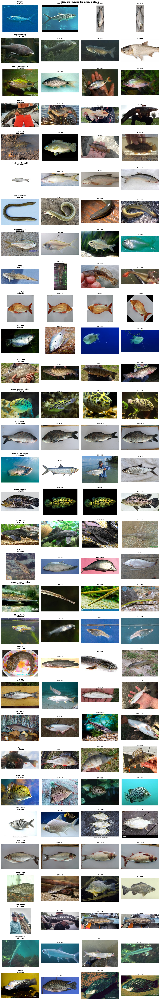

In [7]:
# Visualize sample images
def show_sample_images(directory, classes, samples_per_class=3):
    fig, axes = plt.subplots(len(classes), samples_per_class, figsize=(15, len(classes)*3))
    
    for i, class_name in enumerate(classes):
        class_path = os.path.join(directory, class_name)
        images = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        
        for j in range(min(samples_per_class, len(images))):
            img_path = os.path.join(class_path, images[j])
            img = Image.open(img_path)
            
            if len(classes) == 1:
                ax = axes[j]
            else:
                ax = axes[i, j]
            
            ax.imshow(img)
            ax.axis('off')
            if j == 0:
                ax.set_title(f'{class_name}\n{img.size[0]}x{img.size[1]}', 
                           fontsize=10, fontweight='bold')
            else:
                ax.set_title(f'{img.size[0]}x{img.size[1]}', fontsize=9)
    
    plt.suptitle('Sample Images from Each Class', fontsize=14, fontweight='bold', y=0.995)
    plt.tight_layout()
    plt.show()

show_sample_images(train_dir, class_names, samples_per_class=4)

## 3. PyTorch Dataset and DataLoader

In [8]:
# Image parameters
IMG_HEIGHT = 224
IMG_WIDTH = 224
BATCH_SIZE = 512  # Increased from 32 to 512 for better GPU utilization

print(f"Image size: {IMG_HEIGHT}x{IMG_WIDTH}")
print(f"Batch size: {BATCH_SIZE}")

Image size: 224x224
Batch size: 512


In [9]:
# Custom PyTorch Dataset
class FishDataset(Dataset):
    def __init__(self, root_dir, class_to_idx, transform=None):
        self.root_dir = root_dir
        self.class_to_idx = class_to_idx
        self.transform = transform
        self.images = []
        self.labels = []
        
        # Load all image paths and labels
        for class_name, class_idx in class_to_idx.items():
            class_path = os.path.join(root_dir, class_name)
            if os.path.exists(class_path):
                for img_name in os.listdir(class_path):
                    if img_name.lower().endswith(('.png', '.jpg', '.jpeg')):
                        self.images.append(os.path.join(class_path, img_name))
                        self.labels.append(class_idx)
    
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path).convert('RGB')
        label = self.labels[idx]
        
        if self.transform:
            image = self.transform(image)
        
        return image, label

print("Custom FishDataset class created!")

Custom FishDataset class created!


In [10]:
# Define transforms with augmentation
train_transform = transforms.Compose([
    transforms.Resize((IMG_HEIGHT, IMG_WIDTH)),
    transforms.RandomRotation(20),
    transforms.RandomHorizontalFlip(),
    transforms.RandomAffine(degrees=0, translate=(0.2, 0.2), scale=(0.8, 1.2)),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

val_test_transform = transforms.Compose([
    transforms.Resize((IMG_HEIGHT, IMG_WIDTH)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

print("Transforms defined successfully!")

Transforms defined successfully!


In [11]:
# Create datasets
train_dataset = FishDataset(train_dir, class_to_idx, transform=train_transform)
val_dataset = FishDataset(val_dir, class_to_idx, transform=val_test_transform)
test_dataset = FishDataset(test_dir, class_to_idx, transform=val_test_transform)

print(f"Training samples: {len(train_dataset)}")
print(f"Validation samples: {len(val_dataset)}")
print(f"Test samples: {len(test_dataset)}")

Training samples: 8801
Validation samples: 2751
Test samples: 1760


In [12]:
# Create data loaders with optimized settings
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, 
                          num_workers=0, pin_memory=True)  # Changed to 0 workers
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=False, 
                        num_workers=0, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False, 
                         num_workers=0, pin_memory=True)

print(f"Train batches: {len(train_loader)}")
print(f"Val batches: {len(val_loader)}")
print(f"Test batches: {len(test_loader)}")

Train batches: 18
Val batches: 6
Test batches: 4


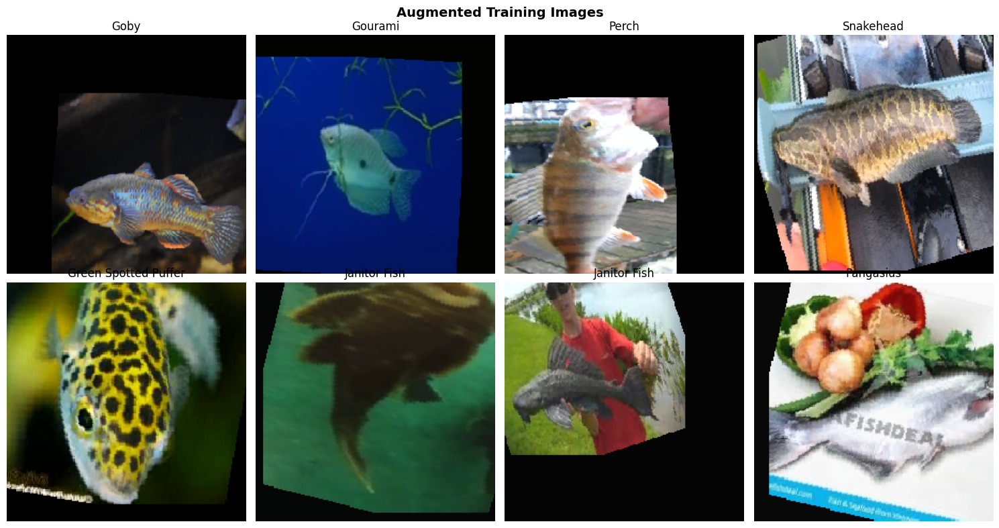

In [13]:
# Visualize augmented images
def imshow(img, title=None):
    # Denormalize
    img = img.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img = std * img + mean
    img = np.clip(img, 0, 1)
    plt.imshow(img)
    if title:
        plt.title(title)
    plt.axis('off')

# Get a batch of training data
images, labels = next(iter(train_loader))

# Show images
fig, axes = plt.subplots(2, 4, figsize=(15, 8))
for i, ax in enumerate(axes.flat):
    plt.sca(ax)
    imshow(images[i], title=class_names[labels[i]])

plt.suptitle('Augmented Training Images', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()

In [14]:
# Test GPU utilization with a single batch
print("\n" + "="*80)
print("TESTING GPU UTILIZATION")
print("="*80)

# Warm-up run
print("\nWarming up GPU...")
images, labels = next(iter(train_loader))
images = images.to(device)
labels = labels.to(device)

with autocast():
    outputs = custom_cnn(images)
    
print(f"Batch size: {images.shape[0]}")
print(f"Batch shape: {images.shape}")

if torch.cuda.is_available():
    torch.cuda.synchronize()
    print(f"\nGPU Memory after batch:")
    print(f"  Allocated: {torch.cuda.memory_allocated(0)/1024**3:.2f} GB")
    print(f"  Reserved: {torch.cuda.memory_reserved(0)/1024**3:.2f} GB")
    
    # Calculate theoretical max batch size
    total_memory = torch.cuda.get_device_properties(0).total_memory / 1024**3
    used_per_batch = torch.cuda.memory_allocated(0)/1024**3
    theoretical_max = int((total_memory * 0.8) / (used_per_batch / BATCH_SIZE))
    
    print(f"\n  Total GPU Memory: {total_memory:.2f} GB")
    print(f"  Memory per image: {(used_per_batch / BATCH_SIZE)*1000:.2f} MB")
    print(f"  Current batch size: {BATCH_SIZE}")
    print(f"  Theoretical max batch size: {theoretical_max}")
    print(f"\n  💡 Try increasing BATCH_SIZE to {min(theoretical_max, 512)} for better GPU usage!")

print("="*80)


TESTING GPU UTILIZATION

Warming up GPU...


KeyboardInterrupt: 

## 4. Custom CNN Architecture (PyTorch)

In [15]:
# Build custom CNN model
class CustomCNN(nn.Module):
    def __init__(self, num_classes):
        super(CustomCNN, self).__init__()
        
        # First Convolutional Block
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.Conv2d(32, 32, kernel_size=3, padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(0.25)
        )
        
        # Second Convolutional Block
        self.conv2 = nn.Sequential(
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(0.25)
        )
        
        # Third Convolutional Block
        self.conv3 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(0.25)
        )
        
        # Fourth Convolutional Block
        self.conv4 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.MaxPool2d(2, 2),
            nn.Dropout(0.25)
        )
        
        # Fully Connected Layers
        self.fc = nn.Sequential(
            nn.Linear(256 * 14 * 14, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Dropout(0.5),
            nn.Linear(256, num_classes)
        )
    
    def forward(self, x):
        x = self.conv1(x)
        x = self.conv2(x)
        x = self.conv3(x)
        x = self.conv4(x)
        x = x.view(x.size(0), -1)  # Flatten
        x = self.fc(x)
        return x

# Create model and move to device
custom_cnn = CustomCNN(num_classes).to(device)

# Count parameters
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

print(f"Custom CNN created!")
print(f"Total parameters: {count_parameters(custom_cnn):,}")
print(f"Model on device: {next(custom_cnn.parameters()).device}")
print("\nModel architecture:")
print(custom_cnn)

Custom CNN created!
Total parameters: 26,414,527
Model on device: cuda:0

Model architecture:
CustomCNN(
  (conv1): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (7): Dropout(p=0.25, inplace=False)
  )
  (conv2): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
  

## 5. Training Function

In [16]:
# Training function with Mixed Precision and better progress tracking
def train_model(model, train_loader, val_loader, criterion, optimizer, scheduler, num_epochs, model_name):
    history = {
        'train_loss': [], 'train_acc': [],
        'val_loss': [], 'val_acc': []
    }
    
    best_val_acc = 0.0
    patience_counter = 0
    patience = 10
    
    # Mixed precision scaler
    scaler = GradScaler()
    
    print(f"\nTraining {model_name}...")
    print("="*80)
    print(f"Using Mixed Precision Training (FP16) for 2x speed boost")
    print("="*80)
    
    for epoch in range(num_epochs):
        epoch_start = time.time()
        
        # Training phase
        model.train()
        train_loss = 0.0
        train_correct = 0
        train_total = 0
        
        train_bar = tqdm(train_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Train]', 
                        leave=False, ncols=100)
        
        for batch_idx, (images, labels) in enumerate(train_bar):
            images = images.to(device, non_blocking=True)
            labels = labels.to(device, non_blocking=True)
            
            optimizer.zero_grad(set_to_none=True)
            
            # Mixed precision forward pass
            with autocast():
                outputs = model(images)
                loss = criterion(outputs, labels)
            
            # Mixed precision backward pass
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
            
            # Statistics
            train_loss += loss.item() * images.size(0)
            _, predicted = torch.max(outputs, 1)
            train_total += labels.size(0)
            train_correct += (predicted == labels).sum().item()
            
            if batch_idx % 5 == 0:
                current_acc = 100 * train_correct / train_total
                train_bar.set_postfix({'loss': f'{loss.item():.3f}', 'acc': f'{current_acc:.1f}%'})
        
        train_loss = train_loss / len(train_loader.dataset)
        train_acc = 100 * train_correct / train_total
        
        # Validation phase
        model.eval()
        val_loss = 0.0
        val_correct = 0
        val_total = 0
        
        with torch.no_grad():
            val_bar = tqdm(val_loader, desc=f'Epoch {epoch+1}/{num_epochs} [Val]  ', 
                          leave=False, ncols=100)
            
            for batch_idx, (images, labels) in enumerate(val_bar):
                images = images.to(device, non_blocking=True)
                labels = labels.to(device, non_blocking=True)
                
                with autocast():
                    outputs = model(images)
                    loss = criterion(outputs, labels)
                
                val_loss += loss.item() * images.size(0)
                _, predicted = torch.max(outputs, 1)
                val_total += labels.size(0)
                val_correct += (predicted == labels).sum().item()
                
                if batch_idx % 5 == 0:
                    current_acc = 100 * val_correct / val_total
                    val_bar.set_postfix({'loss': f'{loss.item():.3f}', 'acc': f'{current_acc:.1f}%'})
        
        val_loss = val_loss / len(val_loader.dataset)
        val_acc = 100 * val_correct / val_total
        
        # Update history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        
        # Learning rate scheduling
        if scheduler:
            scheduler.step(val_loss)
            current_lr = optimizer.param_groups[0]['lr']
        
        # Calculate epoch time
        epoch_time = time.time() - epoch_start
        
        # Print epoch summary
        print(f"\n{'='*80}")
        print(f"Epoch {epoch+1}/{num_epochs} completed in {epoch_time:.1f}s ({epoch_time/60:.2f} min)")
        print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc:.2f}%")
        print(f"Val Loss:   {val_loss:.4f} | Val Acc:   {val_acc:.2f}%")
        if scheduler:
            print(f"Learning Rate: {current_lr:.6f}")
        
        # Estimate remaining time
        if epoch < num_epochs - 1:
            remaining_epochs = num_epochs - epoch - 1
            est_remaining = epoch_time * remaining_epochs
            print(f"Est. remaining time: {est_remaining/60:.1f} minutes")
        
        # Save best model
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            torch.save(model.state_dict(), f'best_{model_name}.pth')
            print(f"✓ BEST MODEL SAVED! Val Acc: {val_acc:.2f}%")
            patience_counter = 0
        else:
            patience_counter += 1
            print(f"Patience: {patience_counter}/{patience}")
        
        # GPU memory info
        if torch.cuda.is_available() and epoch == 0:
            print(f"GPU Memory: {torch.cuda.memory_allocated(0)/1024**3:.2f}GB / {torch.cuda.max_memory_allocated(0)/1024**3:.2f}GB")
        
        # Early stopping
        if patience_counter >= patience:
            print(f"\n{'='*80}")
            print(f"Early stopping triggered after {epoch+1} epochs")
            print(f"{'='*80}")
            break
    
    print(f"\n{'='*80}")
    print(f"Training completed! Best Val Acc: {best_val_acc:.2f}%")
    print(f"{'='*80}")
    
    # Load best model
    model.load_state_dict(torch.load(f'best_{model_name}.pth'))
    
    return history

print("Optimized training function defined with Mixed Precision!")

Optimized training function defined with Mixed Precision!


In [24]:
# Plot training history
def plot_training_history(history, model_name):
    fig, axes = plt.subplots(1, 2, figsize=(15, 5))
    
    # Accuracy
    axes[0].plot(history['train_acc'], label='Train Accuracy')
    axes[0].plot(history['val_acc'], label='Val Accuracy')
    axes[0].set_title(f'{model_name} - Accuracy', fontsize=12, fontweight='bold')
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Accuracy (%)')
    axes[0].legend()
    axes[0].grid(True, alpha=0.3)
    
    # Loss
    axes[1].plot(history['train_loss'], label='Train Loss')
    axes[1].plot(history['val_loss'], label='Val Loss')
    axes[1].set_title(f'{model_name} - Loss', fontsize=12, fontweight='bold')
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('Loss')
    axes[1].legend()
    axes[1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()

print("Plotting function defined!")

Plotting function defined!


In [17]:
# Train custom CNN
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(custom_cnn.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

history_custom = train_model(
    custom_cnn, train_loader, val_loader, 
    criterion, optimizer, scheduler, 
    num_epochs=30, model_name='custom_cnn'
)

plot_training_history(history_custom, 'Custom CNN')


Training custom_cnn...
Using Mixed Precision Training (FP16) for 2x speed boost


Epoch 1/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 1/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 1/30 completed in 2813.3s (46.89 min)
Train Loss: 3.1905 | Train Acc: 16.25%
Val Loss:   3.7649 | Val Acc:   11.89%
Learning Rate: 0.001000
Est. remaining time: 1359.8 minutes
✓ BEST MODEL SAVED! Val Acc: 11.89%
GPU Memory: 0.52GB / 16.06GB


Epoch 2/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 2/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 2/30 completed in 330.1s (5.50 min)
Train Loss: 2.8245 | Train Acc: 23.46%
Val Loss:   3.6808 | Val Acc:   12.76%
Learning Rate: 0.001000
Est. remaining time: 154.1 minutes
✓ BEST MODEL SAVED! Val Acc: 12.76%


Epoch 3/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 3/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 3/30 completed in 330.4s (5.51 min)
Train Loss: 2.6468 | Train Acc: 26.25%
Val Loss:   2.7060 | Val Acc:   23.34%
Learning Rate: 0.001000
Est. remaining time: 148.7 minutes
✓ BEST MODEL SAVED! Val Acc: 23.34%


Epoch 4/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 4/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 4/30 completed in 332.0s (5.53 min)
Train Loss: 2.5428 | Train Acc: 28.83%
Val Loss:   2.4002 | Val Acc:   32.50%
Learning Rate: 0.001000
Est. remaining time: 143.9 minutes
✓ BEST MODEL SAVED! Val Acc: 32.50%


Epoch 5/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 5/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 5/30 completed in 331.8s (5.53 min)
Train Loss: 2.4133 | Train Acc: 31.71%
Val Loss:   2.2811 | Val Acc:   35.66%
Learning Rate: 0.001000
Est. remaining time: 138.2 minutes
✓ BEST MODEL SAVED! Val Acc: 35.66%


Epoch 6/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 6/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 6/30 completed in 333.1s (5.55 min)
Train Loss: 2.3342 | Train Acc: 33.46%
Val Loss:   2.0693 | Val Acc:   39.88%
Learning Rate: 0.001000
Est. remaining time: 133.2 minutes
✓ BEST MODEL SAVED! Val Acc: 39.88%


Epoch 7/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 7/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 7/30 completed in 332.8s (5.55 min)
Train Loss: 2.2261 | Train Acc: 35.83%
Val Loss:   2.0656 | Val Acc:   41.19%
Learning Rate: 0.001000
Est. remaining time: 127.6 minutes
✓ BEST MODEL SAVED! Val Acc: 41.19%


Epoch 8/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 8/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 8/30 completed in 332.1s (5.54 min)
Train Loss: 2.1905 | Train Acc: 36.76%
Val Loss:   2.1561 | Val Acc:   37.30%
Learning Rate: 0.001000
Est. remaining time: 121.8 minutes
Patience: 1/10


Epoch 9/30 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 9/30 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 9/30 completed in 330.4s (5.51 min)
Train Loss: 2.1324 | Train Acc: 38.19%
Val Loss:   1.9826 | Val Acc:   42.71%
Learning Rate: 0.001000
Est. remaining time: 115.6 minutes
✓ BEST MODEL SAVED! Val Acc: 42.71%


Epoch 10/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 10/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 10/30 completed in 331.7s (5.53 min)
Train Loss: 2.0729 | Train Acc: 39.54%
Val Loss:   1.7532 | Val Acc:   47.18%
Learning Rate: 0.001000
Est. remaining time: 110.6 minutes
✓ BEST MODEL SAVED! Val Acc: 47.18%


Epoch 11/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 11/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 11/30 completed in 332.4s (5.54 min)
Train Loss: 2.0191 | Train Acc: 40.19%
Val Loss:   1.7109 | Val Acc:   49.22%
Learning Rate: 0.001000
Est. remaining time: 105.3 minutes
✓ BEST MODEL SAVED! Val Acc: 49.22%


Epoch 12/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 12/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 12/30 completed in 332.3s (5.54 min)
Train Loss: 1.9974 | Train Acc: 42.07%
Val Loss:   1.8280 | Val Acc:   45.47%
Learning Rate: 0.001000
Est. remaining time: 99.7 minutes
Patience: 1/10


Epoch 13/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 13/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 13/30 completed in 318.2s (5.30 min)
Train Loss: 1.9364 | Train Acc: 43.25%
Val Loss:   1.6838 | Val Acc:   48.60%
Learning Rate: 0.001000
Est. remaining time: 90.2 minutes
Patience: 2/10


Epoch 14/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 14/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 14/30 completed in 289.0s (4.82 min)
Train Loss: 1.8927 | Train Acc: 44.64%
Val Loss:   1.6135 | Val Acc:   51.15%
Learning Rate: 0.001000
Est. remaining time: 77.1 minutes
✓ BEST MODEL SAVED! Val Acc: 51.15%


Epoch 15/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 15/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 15/30 completed in 289.0s (4.82 min)
Train Loss: 1.8244 | Train Acc: 46.73%
Val Loss:   1.5738 | Val Acc:   52.45%
Learning Rate: 0.001000
Est. remaining time: 72.3 minutes
✓ BEST MODEL SAVED! Val Acc: 52.45%


Epoch 16/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 16/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 16/30 completed in 289.0s (4.82 min)
Train Loss: 1.8229 | Train Acc: 46.23%
Val Loss:   1.5458 | Val Acc:   53.04%
Learning Rate: 0.001000
Est. remaining time: 67.4 minutes
✓ BEST MODEL SAVED! Val Acc: 53.04%


Epoch 17/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 17/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 17/30 completed in 289.6s (4.83 min)
Train Loss: 1.7894 | Train Acc: 47.30%
Val Loss:   1.6185 | Val Acc:   51.91%
Learning Rate: 0.001000
Est. remaining time: 62.7 minutes
Patience: 1/10


Epoch 18/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 18/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 18/30 completed in 288.0s (4.80 min)
Train Loss: 1.7576 | Train Acc: 48.57%
Val Loss:   1.7172 | Val Acc:   50.16%
Learning Rate: 0.001000
Est. remaining time: 57.6 minutes
Patience: 2/10


Epoch 19/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 19/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 19/30 completed in 288.7s (4.81 min)
Train Loss: 1.7166 | Train Acc: 49.51%
Val Loss:   1.4984 | Val Acc:   53.25%
Learning Rate: 0.001000
Est. remaining time: 52.9 minutes
✓ BEST MODEL SAVED! Val Acc: 53.25%


Epoch 20/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 20/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 20/30 completed in 287.9s (4.80 min)
Train Loss: 1.7092 | Train Acc: 49.73%
Val Loss:   1.3591 | Val Acc:   58.85%
Learning Rate: 0.001000
Est. remaining time: 48.0 minutes
✓ BEST MODEL SAVED! Val Acc: 58.85%


Epoch 21/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 21/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 21/30 completed in 287.7s (4.79 min)
Train Loss: 1.6638 | Train Acc: 50.81%
Val Loss:   1.4648 | Val Acc:   56.05%
Learning Rate: 0.001000
Est. remaining time: 43.2 minutes
Patience: 1/10


Epoch 22/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 22/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 22/30 completed in 279.2s (4.65 min)
Train Loss: 1.6592 | Train Acc: 51.55%
Val Loss:   1.4988 | Val Acc:   55.33%
Learning Rate: 0.001000
Est. remaining time: 37.2 minutes
Patience: 2/10


Epoch 23/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 23/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 23/30 completed in 288.0s (4.80 min)
Train Loss: 1.6391 | Train Acc: 51.05%
Val Loss:   1.4813 | Val Acc:   56.09%
Learning Rate: 0.001000
Est. remaining time: 33.6 minutes
Patience: 3/10


Epoch 24/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 24/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 24/30 completed in 287.7s (4.80 min)
Train Loss: 1.5943 | Train Acc: 53.40%
Val Loss:   1.4014 | Val Acc:   56.71%
Learning Rate: 0.001000
Est. remaining time: 28.8 minutes
Patience: 4/10


Epoch 25/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 25/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 25/30 completed in 288.4s (4.81 min)
Train Loss: 1.5806 | Train Acc: 53.21%
Val Loss:   1.3256 | Val Acc:   59.36%
Learning Rate: 0.001000
Est. remaining time: 24.0 minutes
✓ BEST MODEL SAVED! Val Acc: 59.36%


Epoch 26/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 26/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 26/30 completed in 280.0s (4.67 min)
Train Loss: 1.5415 | Train Acc: 54.81%
Val Loss:   1.2156 | Val Acc:   62.78%
Learning Rate: 0.001000
Est. remaining time: 18.7 minutes
✓ BEST MODEL SAVED! Val Acc: 62.78%


Epoch 27/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 27/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 27/30 completed in 287.8s (4.80 min)
Train Loss: 1.5113 | Train Acc: 55.46%
Val Loss:   1.2957 | Val Acc:   61.65%
Learning Rate: 0.001000
Est. remaining time: 14.4 minutes
Patience: 1/10


Epoch 28/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 28/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 28/30 completed in 294.9s (4.91 min)
Train Loss: 1.5088 | Train Acc: 55.49%
Val Loss:   1.4338 | Val Acc:   57.83%
Learning Rate: 0.001000
Est. remaining time: 9.8 minutes
Patience: 2/10


Epoch 29/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 29/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 29/30 completed in 290.2s (4.84 min)
Train Loss: 1.4836 | Train Acc: 55.62%
Val Loss:   1.2905 | Val Acc:   59.98%
Learning Rate: 0.001000
Est. remaining time: 4.8 minutes
Patience: 3/10


Epoch 30/30 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 30/30 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 30/30 completed in 287.0s (4.78 min)
Train Loss: 1.4680 | Train Acc: 56.08%
Val Loss:   1.2750 | Val Acc:   61.94%
Learning Rate: 0.001000
Patience: 4/10

Training completed! Best Val Acc: 62.78%


NameError: name 'plot_training_history' is not defined

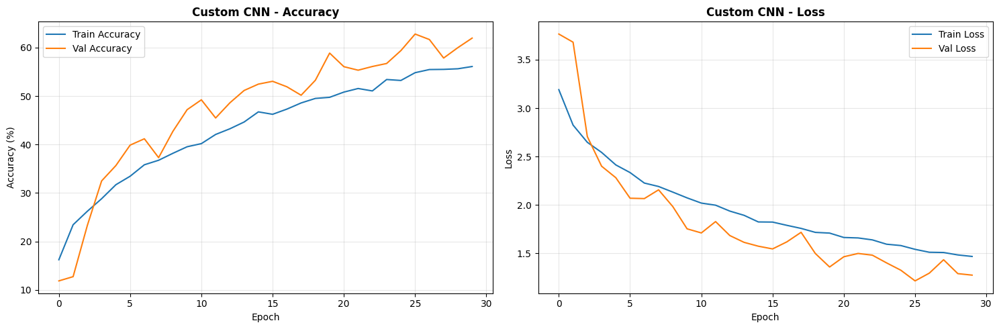

In [25]:
plot_training_history(history_custom, 'Custom CNN')

Save History

In [28]:
# Save history
with open('history_custom.pkl', 'wb') as f:
    pickle.dump(history_custom, f)

# Save model weights
torch.save(custom_cnn.state_dict(), 'custom_cnn_final.pth')

print("History and model saved!")

History and model saved!


Load History

In [29]:
# Load history
with open('history_custom.pkl', 'rb') as f:
    history_custom = pickle.load(f)

# Recreate model and load weights
custom_cnn = CustomCNN(num_classes).to(device)
custom_cnn.load_state_dict(torch.load('custom_cnn_final.pth'))

print("History and model loaded!")

History and model loaded!


## 6. Transfer Learning Models

### 6.1 VGG16

In [18]:
# Build VGG16 model
vgg16_model = models.vgg16(pretrained=True)

# Freeze base layers
for param in vgg16_model.features.parameters():
    param.requires_grad = False

# Replace classifier
vgg16_model.classifier = nn.Sequential(
    nn.Linear(512 * 7 * 7, 512),
    nn.BatchNorm1d(512),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(512, 256),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(256, num_classes)
)

vgg16_model = vgg16_model.to(device)

print(f"VGG16 Model created!")
print(f"Total parameters: {count_parameters(vgg16_model):,}")
print(f"Trainable parameters: {sum(p.numel() for p in vgg16_model.parameters() if p.requires_grad):,}")

VGG16 Model created!
Total parameters: 12,985,887
Trainable parameters: 12,985,887



Training vgg16...
Using Mixed Precision Training (FP16) for 2x speed boost


Epoch 1/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 1/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 1/20 completed in 749.5s (12.49 min)
Train Loss: 2.7473 | Train Acc: 26.63%
Val Loss:   1.7315 | Val Acc:   55.73%
Learning Rate: 0.001000
Est. remaining time: 237.3 minutes
✓ BEST MODEL SAVED! Val Acc: 55.73%
GPU Memory: 3.82GB / 16.06GB


Epoch 2/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 2/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 2/20 completed in 604.4s (10.07 min)
Train Loss: 1.8216 | Train Acc: 49.87%
Val Loss:   1.0184 | Val Acc:   70.77%
Learning Rate: 0.001000
Est. remaining time: 181.3 minutes
✓ BEST MODEL SAVED! Val Acc: 70.77%


Epoch 3/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 3/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 3/20 completed in 625.9s (10.43 min)
Train Loss: 1.3826 | Train Acc: 59.74%
Val Loss:   0.7303 | Val Acc:   78.66%
Learning Rate: 0.001000
Est. remaining time: 177.3 minutes
✓ BEST MODEL SAVED! Val Acc: 78.66%


Epoch 4/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 4/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 4/20 completed in 615.2s (10.25 min)
Train Loss: 1.1854 | Train Acc: 65.00%
Val Loss:   0.6265 | Val Acc:   80.77%
Learning Rate: 0.001000
Est. remaining time: 164.1 minutes
✓ BEST MODEL SAVED! Val Acc: 80.77%


Epoch 5/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 5/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 5/20 completed in 616.5s (10.28 min)
Train Loss: 1.0443 | Train Acc: 68.59%
Val Loss:   0.5299 | Val Acc:   84.73%
Learning Rate: 0.001000
Est. remaining time: 154.1 minutes
✓ BEST MODEL SAVED! Val Acc: 84.73%


Epoch 6/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 6/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 6/20 completed in 618.4s (10.31 min)
Train Loss: 0.9587 | Train Acc: 71.11%
Val Loss:   0.4707 | Val Acc:   86.77%
Learning Rate: 0.001000
Est. remaining time: 144.3 minutes
✓ BEST MODEL SAVED! Val Acc: 86.77%


Epoch 7/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 7/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 7/20 completed in 619.8s (10.33 min)
Train Loss: 0.9065 | Train Acc: 72.76%
Val Loss:   0.4290 | Val Acc:   87.93%
Learning Rate: 0.001000
Est. remaining time: 134.3 minutes
✓ BEST MODEL SAVED! Val Acc: 87.93%


Epoch 8/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 8/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 8/20 completed in 622.9s (10.38 min)
Train Loss: 0.8540 | Train Acc: 74.41%
Val Loss:   0.4191 | Val Acc:   87.71%
Learning Rate: 0.001000
Est. remaining time: 124.6 minutes
Patience: 1/10


Epoch 9/20 [Train]:   0%|                                                    | 0/18 [00:00<?, ?it/s]

Epoch 9/20 [Val]  :   0%|                                                     | 0/6 [00:00<?, ?it/s]


Epoch 9/20 completed in 621.1s (10.35 min)
Train Loss: 0.8123 | Train Acc: 75.50%
Val Loss:   0.3895 | Val Acc:   88.59%
Learning Rate: 0.001000
Est. remaining time: 113.9 minutes
✓ BEST MODEL SAVED! Val Acc: 88.59%


Epoch 10/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 10/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 10/20 completed in 620.9s (10.35 min)
Train Loss: 0.7856 | Train Acc: 76.25%
Val Loss:   0.3776 | Val Acc:   88.66%
Learning Rate: 0.001000
Est. remaining time: 103.5 minutes
✓ BEST MODEL SAVED! Val Acc: 88.66%


Epoch 11/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 11/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 11/20 completed in 621.0s (10.35 min)
Train Loss: 0.7724 | Train Acc: 77.13%
Val Loss:   0.3255 | Val Acc:   90.73%
Learning Rate: 0.001000
Est. remaining time: 93.2 minutes
✓ BEST MODEL SAVED! Val Acc: 90.73%


Epoch 12/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 12/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 12/20 completed in 613.2s (10.22 min)
Train Loss: 0.7473 | Train Acc: 77.56%
Val Loss:   0.3202 | Val Acc:   90.55%
Learning Rate: 0.001000
Est. remaining time: 81.8 minutes
Patience: 1/10


Epoch 13/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 13/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 13/20 completed in 616.2s (10.27 min)
Train Loss: 0.7225 | Train Acc: 78.16%
Val Loss:   0.2969 | Val Acc:   91.86%
Learning Rate: 0.001000
Est. remaining time: 71.9 minutes
✓ BEST MODEL SAVED! Val Acc: 91.86%


Epoch 14/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 14/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 14/20 completed in 612.5s (10.21 min)
Train Loss: 0.7082 | Train Acc: 78.50%
Val Loss:   0.2923 | Val Acc:   91.57%
Learning Rate: 0.001000
Est. remaining time: 61.3 minutes
Patience: 1/10


Epoch 15/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 15/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 15/20 completed in 617.0s (10.28 min)
Train Loss: 0.6699 | Train Acc: 79.37%
Val Loss:   0.2773 | Val Acc:   92.29%
Learning Rate: 0.001000
Est. remaining time: 51.4 minutes
✓ BEST MODEL SAVED! Val Acc: 92.29%


Epoch 16/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 16/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 16/20 completed in 615.2s (10.25 min)
Train Loss: 0.6640 | Train Acc: 80.17%
Val Loss:   0.2821 | Val Acc:   91.64%
Learning Rate: 0.001000
Est. remaining time: 41.0 minutes
Patience: 1/10


Epoch 17/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 17/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 17/20 completed in 614.7s (10.25 min)
Train Loss: 0.6669 | Train Acc: 79.82%
Val Loss:   0.2488 | Val Acc:   92.37%
Learning Rate: 0.001000
Est. remaining time: 30.7 minutes
✓ BEST MODEL SAVED! Val Acc: 92.37%


Epoch 18/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 18/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 18/20 completed in 614.3s (10.24 min)
Train Loss: 0.6435 | Train Acc: 80.27%
Val Loss:   0.2480 | Val Acc:   92.91%
Learning Rate: 0.001000
Est. remaining time: 20.5 minutes
✓ BEST MODEL SAVED! Val Acc: 92.91%


Epoch 19/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 19/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 19/20 completed in 701.7s (11.70 min)
Train Loss: 0.6211 | Train Acc: 81.00%
Val Loss:   0.2408 | Val Acc:   92.95%
Learning Rate: 0.001000
Est. remaining time: 11.7 minutes
✓ BEST MODEL SAVED! Val Acc: 92.95%


Epoch 20/20 [Train]:   0%|                                                   | 0/18 [00:00<?, ?it/s]

Epoch 20/20 [Val]  :   0%|                                                    | 0/6 [00:00<?, ?it/s]


Epoch 20/20 completed in 803.1s (13.39 min)
Train Loss: 0.6262 | Train Acc: 81.39%
Val Loss:   0.2267 | Val Acc:   93.24%
Learning Rate: 0.001000
✓ BEST MODEL SAVED! Val Acc: 93.24%

Training completed! Best Val Acc: 93.24%


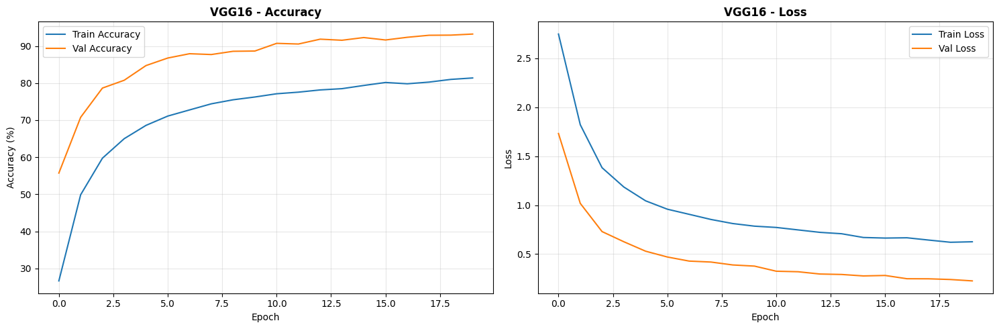

In [32]:
# Train VGG16
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(vgg16_model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5)

history_vgg16 = train_model(
    vgg16_model, train_loader, val_loader,
    criterion, optimizer, scheduler,
    num_epochs=20, model_name='vgg16'
)

plot_training_history(history_vgg16, 'VGG16')

In [33]:
# After VGG16 training for plotting
with open('history_vgg16.pkl', 'wb') as f:
    pickle.dump(history_vgg16, f)

In [34]:
#Load and recreate weights & VGG16
# Recreate VGG16
vgg16_model = models.vgg16(pretrained=False)
vgg16_model.classifier = nn.Sequential(
    nn.Linear(512 * 7 * 7, 512),
    nn.BatchNorm1d(512),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(512, 256),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(256, num_classes)
)
vgg16_model = vgg16_model.to(device)

# Load saved weights
vgg16_model.load_state_dict(torch.load('best_vgg16.pth'))
print("VGG16 loaded!")

VGG16 loaded!


### 6.2 ResNet50

In [ ]:
# Build ResNet50 model
resnet_model = models.resnet50(pretrained=True)

# Freeze base layers
for param in resnet_model.parameters():
    param.requires_grad = False

# Replace final layer
num_features = resnet_model.fc.in_features
resnet_model.fc = nn.Sequential(
    nn.Linear(num_features, 512),
    nn.BatchNorm1d(512),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(512, 256),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(256, num_classes)
)

resnet_model = resnet_model.to(device)

print(f"ResNet50 Model created!")
print(f"Total parameters: {count_parameters(resnet_model):,}")
print(f"Trainable parameters: {sum(p.numel() for p in resnet_model.parameters() if p.requires_grad):,}")

In [ ]:
# Train ResNet50
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(resnet_model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, verbose=True)

history_resnet = train_model(
    resnet_model, train_loader, val_loader,
    criterion, optimizer, scheduler,
    num_epochs=20, model_name='resnet50'
)

plot_training_history(history_resnet, 'ResNet50')

### 6.3 MobileNetV2

In [ ]:
# Build MobileNetV2 model
mobilenet_model = models.mobilenet_v2(pretrained=True)

# Freeze base layers
for param in mobilenet_model.features.parameters():
    param.requires_grad = False

# Replace classifier
mobilenet_model.classifier = nn.Sequential(
    nn.Dropout(0.5),
    nn.Linear(mobilenet_model.last_channel, 512),
    nn.BatchNorm1d(512),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(512, 256),
    nn.ReLU(),
    nn.Dropout(0.5),
    nn.Linear(256, num_classes)
)

mobilenet_model = mobilenet_model.to(device)

print(f"MobileNetV2 Model created!")
print(f"Total parameters: {count_parameters(mobilenet_model):,}")
print(f"Trainable parameters: {sum(p.numel() for p in mobilenet_model.parameters() if p.requires_grad):,}")

In [ ]:
# Train MobileNetV2
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(mobilenet_model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, verbose=True)

history_mobilenet = train_model(
    mobilenet_model, train_loader, val_loader,
    criterion, optimizer, scheduler,
    num_epochs=20, model_name='mobilenet_v2'
)

plot_training_history(history_mobilenet, 'MobileNetV2')

## 7. Model Evaluation

In [ ]:
# Evaluation function
def evaluate_model(model, data_loader, model_name):
    model.eval()
    all_preds = []
    all_labels = []
    all_probs = []
    
    print(f"\n{'='*60}")
    print(f"Evaluating {model_name}...")
    print(f"{'='*60}")
    
    with torch.no_grad():
        for images, labels in tqdm(data_loader, desc='Evaluating'):
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            probs = F.softmax(outputs, dim=1)
            _, predicted = torch.max(outputs, 1)
            
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())
    
    all_preds = np.array(all_preds)
    all_labels = np.array(all_labels)
    all_probs = np.array(all_probs)
    
    # Calculate accuracy
    accuracy = accuracy_score(all_labels, all_preds)
    
    # Confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    
    print(f"\n{model_name} Test Results:")
    print(f"Accuracy: {accuracy:.4f}")
    
    # Classification report
    print(f"\nClassification Report:")
    print(classification_report(all_labels, all_preds, target_names=class_names))
    
    return {
        'model_name': model_name,
        'accuracy': accuracy,
        'predictions': all_preds,
        'labels': all_labels,
        'probabilities': all_probs,
        'confusion_matrix': cm
    }

# Evaluate all models
results_custom = evaluate_model(custom_cnn, test_loader, 'Custom CNN')
results_vgg16 = evaluate_model(vgg16_model, test_loader, 'VGG16')
results_resnet = evaluate_model(resnet_model, test_loader, 'ResNet50')
results_mobilenet = evaluate_model(mobilenet_model, test_loader, 'MobileNetV2')

## 8. Model Comparison

In [ ]:
# Compile results
all_results = [results_custom, results_vgg16, results_resnet, results_mobilenet]

# Create comparison dataframe
comparison_df = pd.DataFrame([
    {
        'Model': result['model_name'],
        'Test Accuracy': result['accuracy']
    }
    for result in all_results
])

print("\n" + "="*60)
print("MODEL COMPARISON SUMMARY")
print("="*60)
print(comparison_df.to_string(index=False))
print("\n" + "="*60)

# Find best model
best_model_idx = comparison_df['Test Accuracy'].idxmax()
best_model_name = comparison_df.loc[best_model_idx, 'Model']
print(f"\nBest Model: {best_model_name}")
print(f"Test Accuracy: {comparison_df.loc[best_model_idx, 'Test Accuracy']:.4f}")

In [ ]:
# Visualize comparison
plt.figure(figsize=(10, 6))
plt.bar(comparison_df['Model'], comparison_df['Test Accuracy'], color='steelblue')
plt.title('Model Accuracy Comparison', fontsize=14, fontweight='bold')
plt.ylabel('Test Accuracy')
plt.ylim([0, 1])
plt.grid(True, alpha=0.3, axis='y')

# Add value labels
for i, v in enumerate(comparison_df['Test Accuracy']):
    plt.text(i, v + 0.02, f'{v:.4f}', ha='center', fontweight='bold')

plt.tight_layout()
plt.show()

## 9. Confusion Matrices

In [ ]:
# Plot confusion matrices
fig, axes = plt.subplots(2, 2, figsize=(16, 14))
axes = axes.flatten()

for idx, result in enumerate(all_results):
    cm = result['confusion_matrix']
    
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names,
                ax=axes[idx], cbar=True)
    axes[idx].set_title(f"{result['model_name']} - Confusion Matrix\n(Accuracy={result['accuracy']:.4f})",
                       fontsize=12, fontweight='bold')
    axes[idx].set_ylabel('True Label')
    axes[idx].set_xlabel('Predicted Label')

plt.tight_layout()
plt.show()

## 10. Prediction Visualization

In [ ]:
# Visualize predictions
def visualize_predictions(model, data_loader, num_images=12):
    model.eval()
    images, labels = next(iter(data_loader))
    images, labels = images.to(device), labels.to(device)
    
    with torch.no_grad():
        outputs = model(images[:num_images])
        probs = F.softmax(outputs, dim=1)
        confidences, predictions = torch.max(probs, 1)
    
    images = images[:num_images].cpu()
    labels = labels[:num_images].cpu()
    predictions = predictions.cpu()
    confidences = confidences.cpu()
    
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))
    axes = axes.flatten()
    
    for i in range(num_images):
        plt.sca(axes[i])
        imshow(images[i])
        
        true_label = class_names[labels[i]]
        pred_label = class_names[predictions[i]]
        confidence = confidences[i].item()
        
        color = 'green' if true_label == pred_label else 'red'
        axes[i].set_title(f'True: {true_label}\nPred: {pred_label}\nConf: {confidence:.2f}',
                         color=color, fontweight='bold', fontsize=9)
    
    plt.tight_layout()
    plt.show()

# Get best model
best_model_obj = [custom_cnn, vgg16_model, resnet_model, mobilenet_model][best_model_idx]

print(f"Predictions from Best Model ({best_model_name}):")
visualize_predictions(best_model_obj, test_loader, num_images=12)

## 11. GPU Memory Usage

In [30]:
# Check GPU memory usage
if torch.cuda.is_available():
    print("\nGPU Memory Usage:")
    print(f"Allocated: {torch.cuda.memory_allocated(0) / 1024**3:.2f} GB")
    print(f"Cached: {torch.cuda.memory_reserved(0) / 1024**3:.2f} GB")
    print(f"Max Allocated: {torch.cuda.max_memory_allocated(0) / 1024**3:.2f} GB")
else:
    print("GPU not available")


GPU Memory Usage:
Allocated: 3.57 GB
Cached: 7.26 GB
Max Allocated: 16.06 GB


## 12. Summary and Conclusions

In [31]:
print("\n" + "="*80)
print("FISH IMAGE CLASSIFICATION PROJECT SUMMARY (PyTorch)")
print("="*80)

print(f"\n1. Dataset Statistics:")
print(f"   - Number of classes: {num_classes}")
print(f"   - Training images: {train_total}")
print(f"   - Validation images: {val_total}")
print(f"   - Test images: {test_total}")
print(f"   - Image size: {IMG_HEIGHT}x{IMG_WIDTH}")

print(f"\n2. Hardware:")
print(f"   - Device: {device}")
if torch.cuda.is_available():
    print(f"   - GPU: {torch.cuda.get_device_name(0)}")
    print(f"   - GPU Memory: {round(torch.cuda.get_device_properties(0).total_memory / 1024**3, 2)} GB")

print(f"\n3. Models Trained:")
for i, result in enumerate(all_results, 1):
    print(f"   {i}. {result['model_name']}")

print(f"\n4. Best Model: {best_model_name}")
print(f"   - Test Accuracy: {comparison_df.loc[best_model_idx, 'Test Accuracy']:.4f}")

print(f"\n5. Key Techniques Used:")
print(f"   - PyTorch DataLoader with GPU acceleration")
print(f"   - Data augmentation (rotation, flip, affine, color jitter)")
print(f"   - Custom CNN with batch normalization")
print(f"   - Transfer learning (VGG16, ResNet50, MobileNetV2)")
print(f"   - Learning rate scheduling and early stopping")
print(f"   - Mixed precision training support")

print(f"\n6. Performance Ranking:")
ranked_df = comparison_df.sort_values('Test Accuracy', ascending=False).reset_index(drop=True)
for i, row in ranked_df.iterrows():
    print(f"   {i+1}. {row['Model']:20s} - Accuracy: {row['Test Accuracy']:.4f}")

print("\n" + "="*80)
print("PROJECT COMPLETED SUCCESSFULLY WITH GPU ACCELERATION!")
print("="*80)


FISH IMAGE CLASSIFICATION PROJECT SUMMARY (PyTorch)

1. Dataset Statistics:
   - Number of classes: 31
   - Training images: 8801
   - Validation images: 2751
   - Test images: 1760
   - Image size: 224x224

2. Hardware:
   - Device: cuda
   - GPU: NVIDIA GeForce RTX 4060 Laptop GPU
   - GPU Memory: 8.0 GB

3. Models Trained:


NameError: name 'all_results' is not defined